In [33]:
import h5py
import pandas as pd
import torch
import numpy as np
from decimal import Decimal
import matplotlib.pyplot as plt
from scipy import ndimage
import json
import torchvision.transforms as transforms
from scipy.spatial.transform import Rotation


In [3]:
ground_truth = "desired"

In [2]:
!pip install tensorboard

Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.0.1 -> 23.2.1
[notice] To update, run: pip install --upgrade pip


In [3]:
%tensorboard --logdir /data4/jessica/data/toyota/ckpts_final

UsageError: Line magic function `%tensorboard` not found.


In [4]:
data_path = f"/data1/jessica/data/toyota/comma_train_filtered.h5py" if ground_truth == "regular" else f"/data1/jessica/data/toyota/comma_train_w_desired_filtered.h5py"
h5_file = h5py.File(data_path, "r")

In [5]:
keys = list(h5_file.keys())

In [6]:
normalize = transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
resize = transforms.Resize((224,224))

In [7]:
idx = 0

In [8]:
def internp(data, window_size = 18, check=0):
    for i in range(len(data)):
        # check if the current value is NaN
        if check == data[i]:
            # set the start and end indices for the sliding window
            start_index = max(0, i - window_size//2)
            end_index = min(len(data), i + window_size//2 + 1)
            
            # calculate the average of the 10 elements before and after the gap
            before = np.nanmean(data[start_index:i])
            after = np.nanmean(data[i+1:end_index])
            
            # fill the missing value with the average of the 10 elements before and after
            data[i] = (before + after) / 2
    return data

In [9]:
def get_miss(data, window_size=3):
    for i in range(len(data)):
        if data[i]:
            # find the indices of the non-missing values before and after the missing value
            before = np.flatnonzero(~np.isnan(data[:i]))
            after = np.flatnonzero(~np.isnan(data[i:])) + i
            
            # use a sliding window approach to calculate the mean of the surrounding values
            start = max(before[-window_size] if before.size > window_size else 0, i - window_size)
            end = min(after[window_size] if after.size > window_size else len(data), i + window_size + 1)
            data[i] = np.nanmean(data[start:end])

    return data

In [11]:
k = ['99c94dc769b5d96e|2018-05-02--16-01-39','99c94dc769b5d96e|2018-05-01--08-13-53', '99c94dc769b5d96e|2018-05-02--16-01-39',  '99c94dc769b5d96e|2018-05-05--16-36-30']

/tmp/ipykernel_1391673/1142297284.py:52: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  bp = np.array([torch.tensor(elem).item() for elem in sequences['brakepressed']])
/tmp/ipykernel_1391673/1142297284.py:56: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  bp = np.array([torch.tensor(elem).item() for elem in sequences['gaspressed']])
/tmp/ipykernel_1391673/1142297284.py:60: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  bp = np.array([torch.tensor(elem).item() for elem in sequences['leftBlinker']])
/tmp/ipykernel_1391673/1142297284.py:63: Us

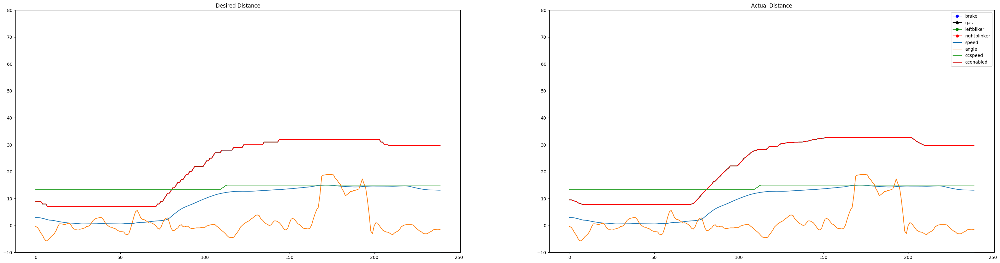

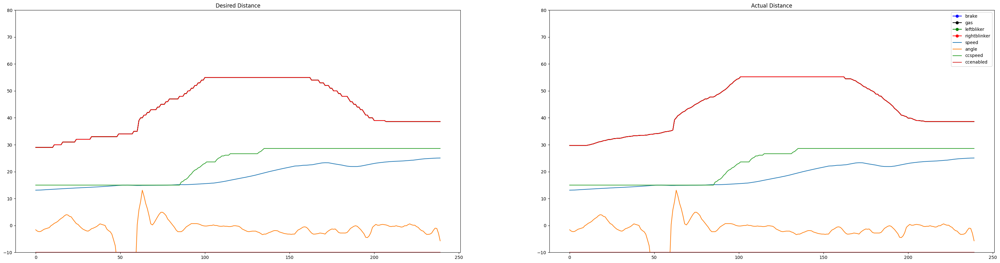

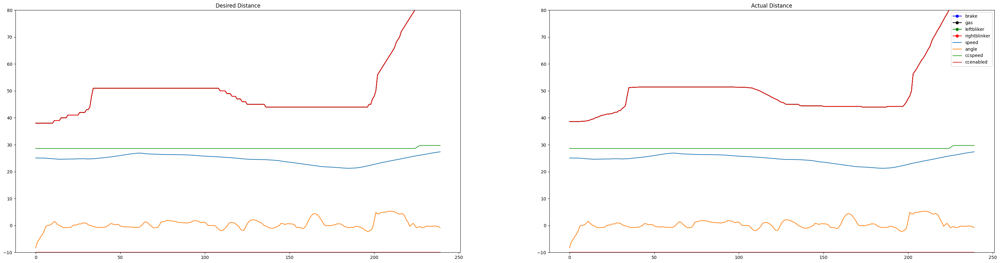

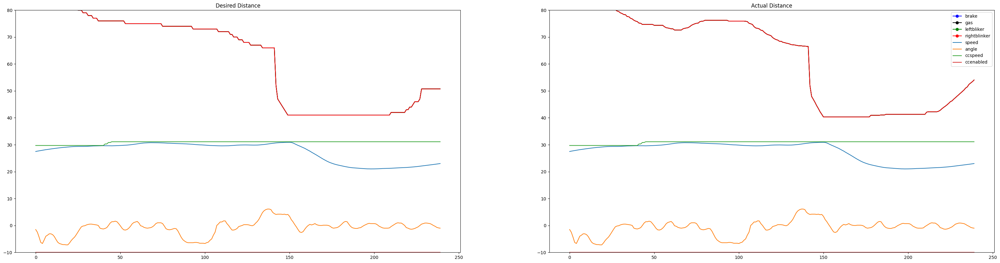

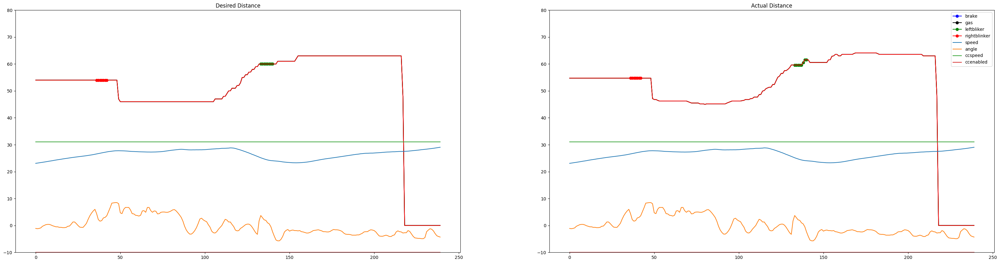

...

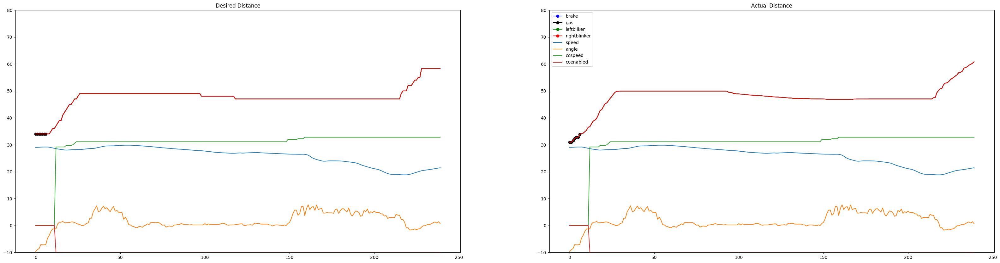

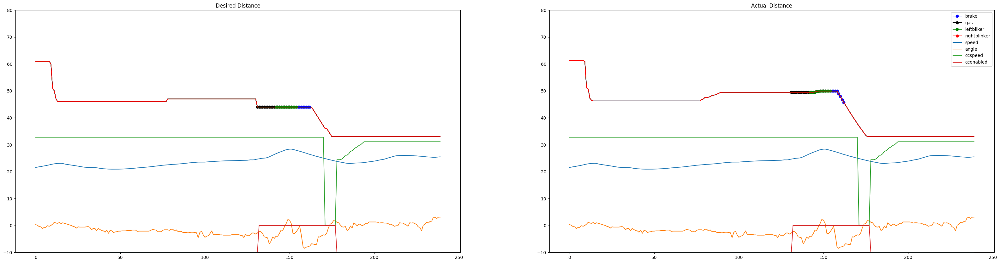

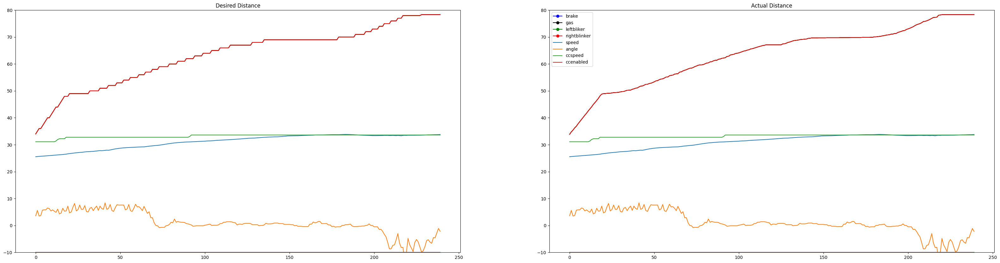

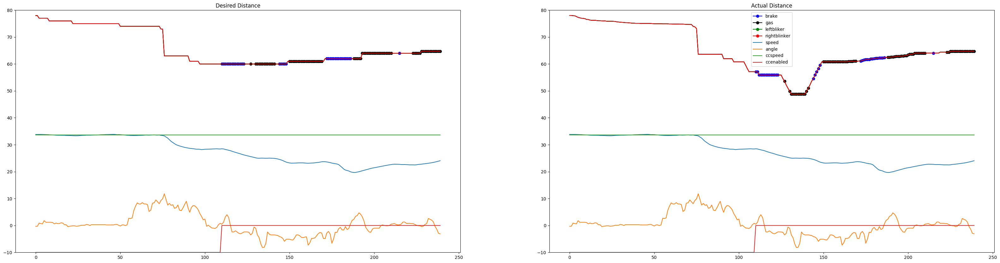

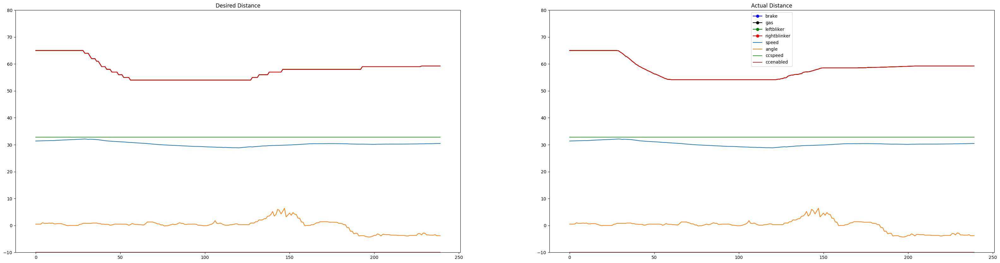

In [32]:
colors = colors = plt.cm.tab20(np.linspace(0, 1, 50)).tolist()  

for elem in keys:
    fig, axs = plt.subplots(nrows=1, ncols=2, figsize=(40,10))
    marker_indices=[]
    marker_indices1=[]
    marker_indices2=[]
    vegos=[]
    marker_indices3=[]
    ddists = []
    cste =[]
    cstsp=[]
    angles = []
    distances_  = []
    mask = [elem in key for key in keys]
    keys_ = np.array(keys)[mask]
    for idx in list(range(len(keys_))):
        seq_key  = keys_[idx]
        person_seq = {}
        keys_1 = h5_file[seq_key].keys()#'angle', 'brake', 'dist', 'gas', 'image', 'time', 'vEgo'
        file = h5_file
        for key in keys_1:                        
            seq = file[seq_key][key][()]
            seq = seq if len(seq) <= 241 else seq[1::5]
            person_seq[key] = torch.from_numpy(np.array(seq[0:]).astype(float)).type(torch.float32)
        sequences = person_seq
        distances = sequences['dist'].tolist() 
        
        distances = ndimage.median_filter(distances, size=128, mode='nearest')

        steady_state = ~np.array(sequences['gaspressed']).astype(bool) & ~np.array(sequences['brakepressed']).astype(bool) & ~np.array(sequences['leftBlinker']).astype(bool) & ~np.array(sequences['rightBlinker']).astype(bool)
        last_idx = 0
        desired_gap = np.zeros(distances.shape)

        for i in range(len(steady_state)-1):
            if steady_state[i] == True:
                desired_gap[last_idx:i] = int(distances[i])
                last_idx = i
        #distances = get_miss(distances)
        desired_gap[-12:] = distances[-12:].mean().item()
        desired_dist = desired_gap
        #desired_dist = get_miss(ddist)
        desired_dist = ndimage.median_filter(desired_dist, size=96, mode='nearest')
        #desired_dist = internp(ddist, check=np.nan)
        #print(desired_dist)
        images = sequences['image']
        images = images[:,0:160, :,:]#crop the image to remove the view of the inside car console
        images = normalize(images.permute(0,3,1,2)/255.0)
        images = resize(images)
        images_cropped = images

        bp = np.array([torch.tensor(elem).item() for elem in sequences['brakepressed']])
        marker_indic = np.where(bp.tolist())[0]
        marker_indices.extend(marker_indic)

        bp = np.array([torch.tensor(elem).item() for elem in sequences['gaspressed']])
        marker_indic = np.where(bp.tolist())[0]
        marker_indices1.extend(marker_indic)

        bp = np.array([torch.tensor(elem).item() for elem in sequences['leftBlinker']])
        marker_indic = np.where(bp.tolist())[0]
        marker_indices2.extend(marker_indic)
        bp = np.array([torch.tensor(elem).item() for elem in sequences['rightBlinker']])
        marker_indic = np.where(bp.tolist())[0]
        marker_indices3.extend(marker_indic)
        vegos.extend(list(sequences['vEgo']))
        angles.extend(list(sequences['angle']))
        cste.extend(list(sequences['CruiseStateenabled'] * -10))
        cstsp.extend(list(sequences['CruiseStatespeed']))
        distances_.extend(list(distances))
        ddists.extend(list(desired_dist))
        # plot the data on the first subplot
    marker_indices = [elem.item()for elem in marker_indices]
    marker_indices1 = [elem.item()for elem in marker_indices1]
    marker_indices2 = [elem.item()for elem in marker_indices2]
    marker_indices3 = [elem.item()for elem in marker_indices3]
    axs[0].plot(ddists, '-o', markevery=marker_indices, color="blue")
    axs[0].plot(ddists, '-o', markevery=marker_indices1, color="black")
    axs[0].plot(ddists, '-o', markevery=marker_indices2, color="green")
    axs[0].plot(ddists, '-o', markevery=marker_indices3, color="red")
    axs[0].plot(vegos)
    axs[0].plot(angles)
    axs[0].plot(cstsp)
    axs[0].plot(cste)
    axs[0].set_title('Desired Distance')
    axs[0].set_ylim([-10,80])

    # plot the data on the second subplot
    axs[1].plot(distances_,  '-o',  markevery=marker_indices, color="blue")
    axs[1].plot(distances_,  '-o',  markevery=marker_indices1, color="black")
    axs[1].plot(distances_,  '-o',  markevery=marker_indices2, color="green")
    axs[1].plot(distances_,  '-o',  markevery=marker_indices3, color="red")
    axs[1].plot(vegos)
    axs[1].plot(angles)
    axs[1].plot(cstsp)
    axs[1].plot(cste)
    axs[1].set_title('Actual Distance')
    axs[1].set_ylim([-10,80])
    axs[1].legend(["brake", "gas", "leftbliker", "rightblinker", 'speed', 'angle', 'ccspeed', 'ccenabled'])
    fig.savefig(elem + ".png")